# Panfetal unconventional T
# 9 Nov 2021 Chenqu

In [1]:
import numpy as np
import scipy as sp
import scanpy as sc
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import rc
from matplotlib import colors
import seaborn as sb
from itertools import compress
import random
import joblib as jl
import matplotlib.patches as mpatches

sc.settings.set_figure_params(dpi = 160, color_map = 'RdYlBu_r', dpi_save = 300, format = 'pdf')
plt.rcParams["figure.figsize"] = [6,6]
#plt.rcParams['font.sans-serif']=['Arial']
#rc('font', **{'family':'sans-serif', 'sans-serif':['Arial']})
#plt.rcParams['pdf.fonttype'] = 'truetype'

In [2]:
sb.set_palette('tab10')

In [3]:
# import utils
import sys
sys.path.append('/home/jovyan/chenqu_utils')
from array_operations import *
sys.path.append('/home/jovyan/thymusatlas/')
import scjp
from scjp import model

In [4]:
organ_order = ['YS','LI','BM','TH','SP','MLN','SK','GU','KI']

In [5]:
# set working directory
%cd /home/jovyan/panfetal/

/home/jovyan/panfetal


In [6]:
# figure directory
fig_path = '/home/jovyan/mount/gdrive/Pan_fetal/plots_output/chenqu_jhub/'
sc.settings.figdir = fig_path

# Load data

In [7]:
adata = sc.read('/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.20210429.NKT.embedding.h5ad')

Only considering the two last: ['.embedding', '.h5ad'].
Only considering the two last: ['.embedding', '.h5ad'].


In [8]:
adata.raw = adata.copy()

### exclude maternal contaminants

In [9]:
maternal_barcodes = pd.read_csv('souporcell/maternal_barcodes.csv')

In [10]:
maternal_barcodes['barcodes'] = [barcode.split('-')[0]+'-'+barcode.split('-')[1] for barcode in maternal_barcodes['x']]

In [11]:
print(sum(adata.obs_names.isin(maternal_barcodes['barcodes'])))
adata = adata[~adata.obs_names.isin(maternal_barcodes['barcodes'])]

2086


### update annotation with anno_lvl_2_final_clean

In [133]:
obs = pd.read_csv('/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv', index_col = 0) # final annotations and removed maternal contaminant cells

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (6) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [13]:
for col in obs:
    adata.obs[col] = obs[col] # use anno_lvl_2_final_clean

Trying to set attribute `.obs` of view, copying.


In [14]:
adata.write_h5ad('write/NKT_final.h5ad')

... storing 'file' as categorical
... storing 'predicted_doublets' as categorical
... storing 'name' as categorical
... storing 'uniform_label' as categorical
... storing 'uniform_label_expanded_merged' as categorical
... storing 'uniform_label_lvl0' as categorical
... storing 'organ' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sort_id' as categorical
... storing 'method' as categorical
... storing 'donor' as categorical
... storing 'sex' as categorical
... storing 'Processing_method' as categorical
... storing 'AnnatomicalPart' as categorical
... storing 'Sample' as categorical
... storing 'anno_lvl_2_final_clean' as categorical


In [7]:
adata= sc.read('write/NKT_final.h5ad')

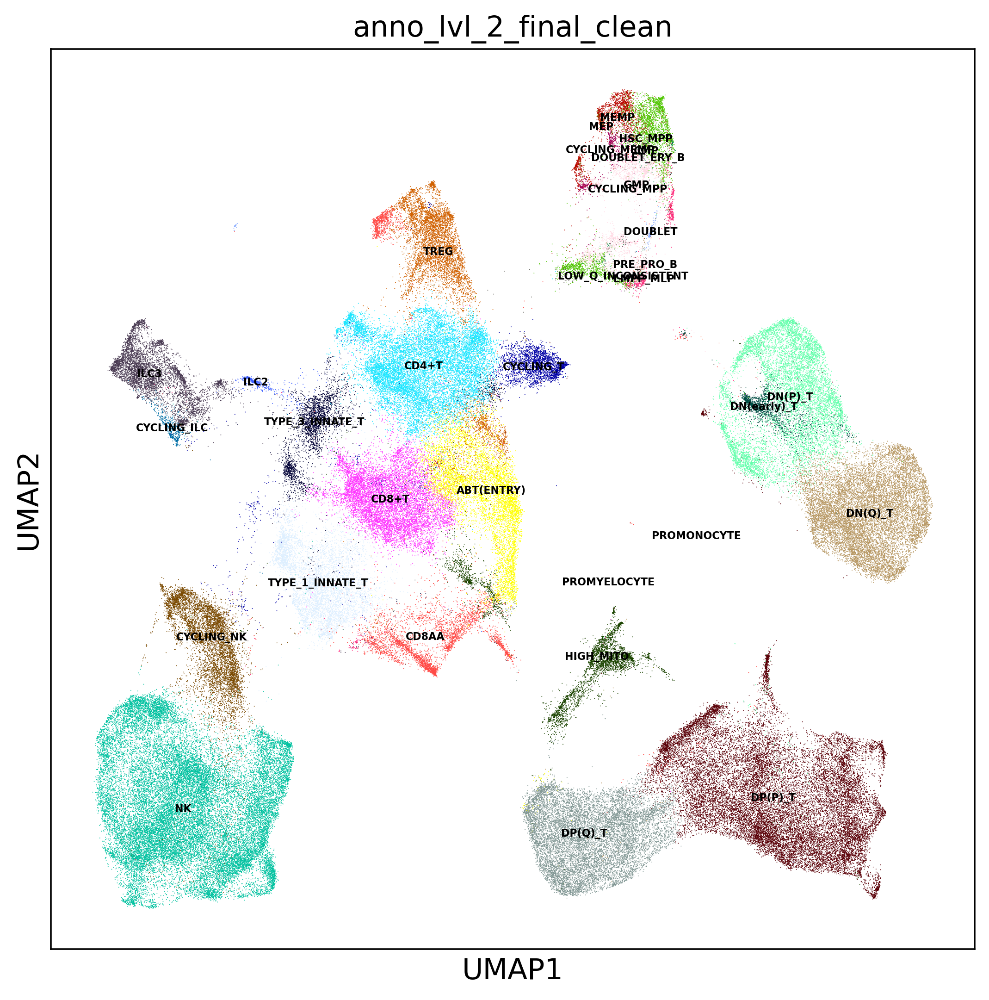

In [8]:
plt.rcParams["figure.figsize"] = [8,8]
sc.pl.umap(adata,color=['anno_lvl_2_final_clean'],legend_loc='on data',legend_fontsize=5)

# Load abTCR and gdTCR

In [9]:
meta_gd = pd.read_csv('metadata/gdTCR_metadata_02082021.csv',index_col=0)
gdtcr = pd.read_csv('csv/gdTCR_filtered_contig_merged_qc.csv',index_col=0)
gdtcr.columns=['gd_'+name for name in gdtcr.columns]

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (2,3,5,15,17,19,21,22,23,25,26,29,30,31,33,34,35,37) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [18]:
for col in gdtcr:
    adata.obs[col] = gdtcr[col]

In [10]:
meta_ab = pd.read_csv('metadata/TCR_metadata_updated_20052021.csv',index_col=0)
meta_ab = meta_ab[meta_ab['type']=='VDJT']
abtcr = pd.read_csv('csv/abTCR_filtered_contig_merged_qc.csv',index_col=0)
abtcr.columns=['ab_'+name for name in abtcr.columns]

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (14,15,17,18,19,21) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [20]:
for col in abtcr:
    adata.obs[col] = abtcr[col]

In [21]:
a = list(adata.obs['gd_receptor_subtype']=='TRG+TRD')
b = list(adata.obs['gd_chain_pairing'].isin(['single pair','extra VJ','extra VDJ','two full chains']))
c = [a and b for a,b in zip(a,b)]
adata.obs.loc[c,'gdTCR'] = 'paired_gdTCR'
d = list(adata.obs['ab_receptor_subtype']=='TRA+TRB')
e = list(adata.obs['ab_chain_pairing'].isin(['single pair','extra VJ','extra VDJ','two full chains']))
f = [d and e for d,e in zip(d,e)]
adata.obs.loc[f,'abTCR'] = 'paired_abTCR'

In [22]:
df = [c and f for c,f in zip(c,f)]
sum(df) # five cells that have both paired gdTCR and abTCR

5

In [23]:
adata.write_h5ad('write/NKT_final_TCR.h5ad')

... storing 'gd_multi_chain' as categorical
... storing 'gd_IR_VJ_1_locus' as categorical
... storing 'gd_IR_VJ_2_locus' as categorical
... storing 'gd_IR_VDJ_1_locus' as categorical
... storing 'gd_IR_VDJ_2_locus' as categorical
... storing 'gd_IR_VJ_1_cdr3' as categorical
... storing 'gd_IR_VJ_2_cdr3' as categorical
... storing 'gd_IR_VDJ_1_cdr3' as categorical
... storing 'gd_IR_VDJ_2_cdr3' as categorical
... storing 'gd_IR_VJ_1_cdr3_nt' as categorical
... storing 'gd_IR_VJ_2_cdr3_nt' as categorical
... storing 'gd_IR_VDJ_1_cdr3_nt' as categorical
... storing 'gd_IR_VDJ_2_cdr3_nt' as categorical
... storing 'gd_IR_VJ_2_expr' as categorical
... storing 'gd_IR_VDJ_2_expr' as categorical
... storing 'gd_IR_VJ_2_expr_raw' as categorical
... storing 'gd_IR_VDJ_2_expr_raw' as categorical
... storing 'gd_IR_VJ_1_v_gene' as categorical
... storing 'gd_IR_VJ_2_v_gene' as categorical
... storing 'gd_IR_VDJ_1_v_gene' as categorical
... storing 'gd_IR_VDJ_2_v_gene' as categorical
... storing 'g

In [11]:
adata = sc.read('write/NKT_final_TCR.h5ad')

In [12]:
## proportion of mature T cells from thymus
matureT = adata[adata.obs['anno_lvl_2_final_clean'].isin(['CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T','CYCLING_T'])]
1- Counter(matureT.obs['organ'])['TH'] / matureT.obs.shape[0]

0.5769396737723311

# Select mature T cells

In [13]:
a = adata.obs['anno_lvl_2_final_clean'].isin(['CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'])
b = ~(adata.obs['Sort_id'].isin(['CD137','MAIT']))
c = [a and b for a,b in zip(a,b)]
T = adata[c].copy()

In [14]:
T.obs['anno_lvl_2_final_clean'] = T.obs['anno_lvl_2_final_clean'].cat.reorder_categories(['CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'])

In [15]:
a = np.array(T.obsm['X_umap'][:,0]>-3) & np.array(T.obsm['X_umap'][:,0]<8) & np.array(T.obsm['X_umap'][:,1]>-2)
T_plot = T[a].copy()

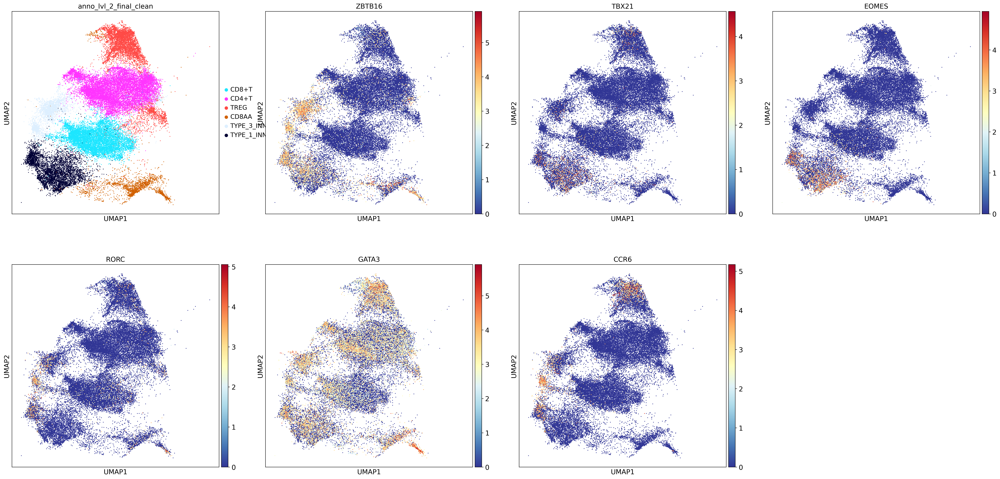

In [16]:
sc.pl.umap(T_plot, color=['anno_lvl_2_final_clean','ZBTB16','TBX21','EOMES','RORC','GATA3','CCR6'], size = 10)

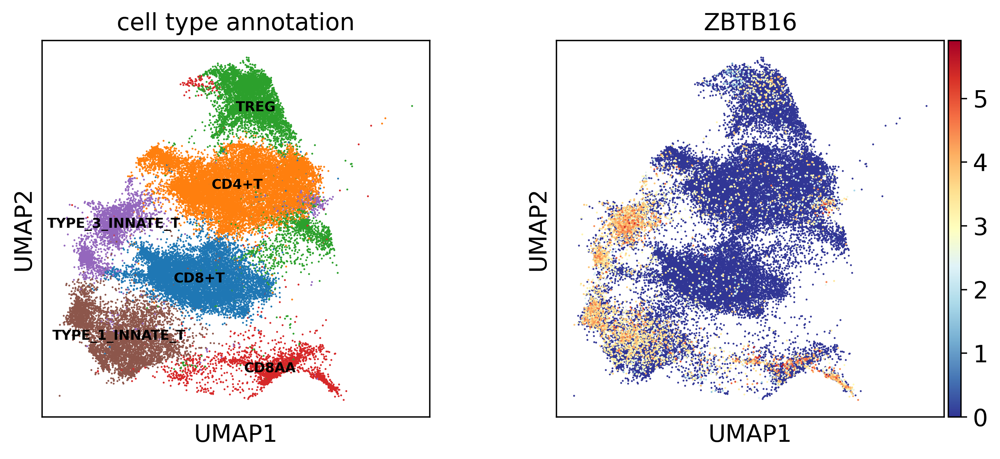

In [17]:
plt.rcParams["figure.figsize"] = [4,4]
sc.pl.umap(T_plot, color=['anno_lvl_2_final_clean','ZBTB16'],legend_loc='on data',legend_fontsize=8,size=5, title=['cell type annotation','ZBTB16'],
          palette = scjp.colors.vega_20_scanpy,save='matureT_ZBTB16.pdf')

# Plot unconventional / conventional T ratio across organ and age

In [19]:
adata_select = T.copy()
adata_select.obs['donor_organ']=np.char.array(adata_select.obs['donor'],unicode=True)+'_'+np.char.array(adata_select.obs['organ'],unicode=True)
adata_select.obs['donor_organ']=adata_select.obs['donor_organ'].astype('category')

In [20]:
cc1 = pd.DataFrame(index =list(adata_select.obs['donor_organ'].cat.categories), columns = list(adata_select.obs['anno_lvl_2_final_clean'].cat.categories)+['total'])

In [21]:
for donor_organ in cc1.index:
    counter = Counter(adata_select[adata_select.obs['donor_organ']==donor_organ].obs['anno_lvl_2_final_clean'])
    cc1.loc[donor_organ,'total']=sum(adata_select.obs['donor_organ']==donor_organ)
    for cell in cc1.columns[:-1]:
        cc1.loc[donor_organ,cell] = counter[cell]
    #cluster_counter.loc['B1%',sample]=counterB1[sample] / counterB[sample]
cc1 = cc1.astype('int64')

In [22]:
cc1['age'] = lookup(cc1.index, adata_select.obs, 'donor_organ', 'age')
cc1['organ'] = lookup(cc1.index, adata_select.obs, 'donor_organ', 'organ')

In [23]:
cc2 = cc1.loc[:,['TYPE_3_INNATE_T','TYPE_1_INNATE_T','CD8AA','total','age','organ']].copy()
#cc2.loc[:,['Th17','NKT','CD8αα']] = cc2.loc[:,['Th17','NKT','CD8αα']] / np.array(cc2['total']).reshape(23,1) * 100

In [24]:
bin_names = np.array(['7-9 pcw', '10-12 pcw', '13-15 pcw', '16-17 pcw']) # bin ages 
cc2['age_bin'] = bin_names[np.digitize(cc2['age'], [10, 13, 16])]
cc2['age_bin'] = cc2['age_bin'].astype('category').cat.reorder_categories(bin_names)
cc2['age_organ'] = cc2['age_bin'].astype('str') + '_' + cc2['organ'].astype('str')

In [25]:
tmp = cc2.groupby(['age_organ']).agg('sum')
cc3 = cc2.groupby(['age_organ']).first()
cc3.iloc[:,0:4] = tmp.iloc[:,0:4]

In [26]:
cc3['unconventional%']=(cc3['TYPE_3_INNATE_T']+cc3['TYPE_1_INNATE_T']+cc3['CD8AA'])/cc3['total'] * 100

In [27]:
cc3['organ']=cc3['organ'].astype('category')
cc3['organ']=cc3['organ'].cat.set_categories(organ_order).cat.remove_unused_categories()
organ_color_map = dict(zip(organ_order, np.array(sb.color_palette('tab10'))[range(len(organ_order))]))

In [28]:
cc3

,TYPE_3_INNATE_T,TYPE_1_INNATE_T,CD8AA,total,age,organ,age_bin,unconventional%
age_organ,,,,,,,,
10-12 pcw_BM,9,11,0,99,12.0,BM,10-12 pcw,20.202020
10-12 pcw_GU,1,3,1,8,12.0,GU,10-12 pcw,62.500000
10-12 pcw_KI,9,19,0,94,12.0,KI,10-12 pcw,29.787234
10-12 pcw_LI,50,125,18,353,11.0,LI,10-12 pcw,54.674221
10-12 pcw_SK,29,75,3,1439,10.0,SK,10-12 pcw,7.435719
10-12 pcw_SP,82,469,30,1038,11.0,SP,10-12 pcw,55.973025
10-12 pcw_TH,502,244,997,6421,11.0,TH,10-12 pcw,27.145304
13-15 pcw_BM,14,106,9,294,14.0,BM,13-15 pcw,43.877551
13-15 pcw_GU,179,137,38,887,15.0,GU,13-15 pcw,39.909808


/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


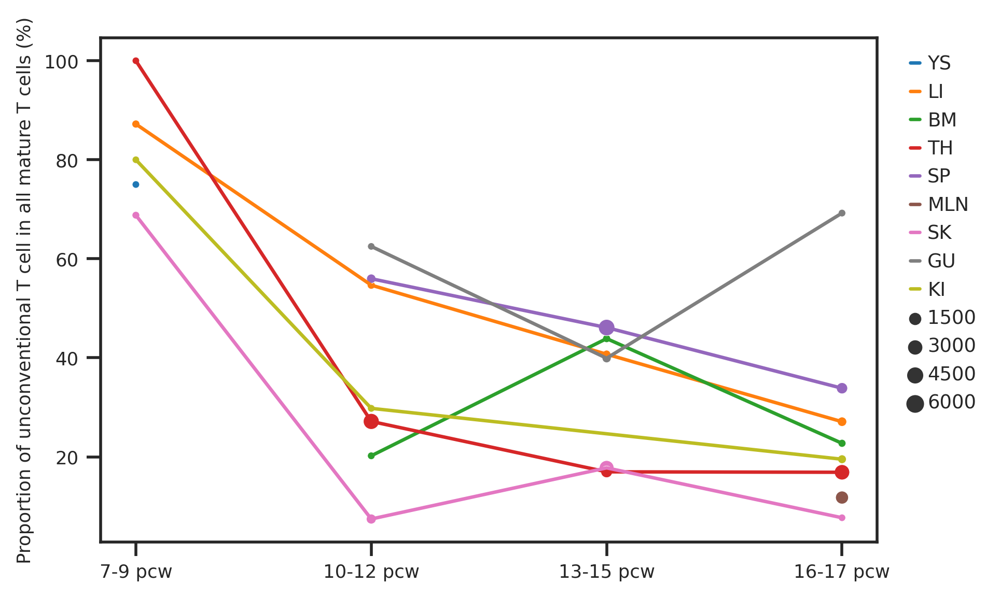

In [29]:
sb.set_theme(style='ticks')
fig, ax = plt.subplots(figsize=(6,4))
g = sb.lineplot(data=cc3, x='age_bin', y='unconventional%',hue='organ',palette=organ_color_map)
s = sb.scatterplot(cc3.loc[:,'age_bin'], cc3.loc[:,'unconventional%'],hue=cc3.loc[:,'organ'],
                    size =np.array(cc3.loc[:,'total'], dtype='float'),
                   sizes=(10, 50),palette=organ_color_map)
s.set_ylabel('Proportion of unconventional T cell in all mature T cells (%)', fontsize=8)
s.set(xlabel='')
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
ax.xaxis.grid(False)
h,l = ax.get_legend_handles_labels()
l1 = ax.legend(h[:9]+h[-4:],l[:9]+l[-4:], loc='upper left',bbox_to_anchor=(1.02, 1),frameon=False, fontsize='x-small')
plt.savefig(fig_path+'unconventionalT%_fetal_organ.pdf',bbox_inches='tight')

# Plot % unconventional T cell subtype within thymus dataset

In [30]:
jp_thymus = sc.read('/home/jovyan/thymusatlas/HTA08.v01.A05.Science_human_fig1.h5ad')

Only considering the two last: ['.Science_human_fig1', '.h5ad'].
Only considering the two last: ['.Science_human_fig1', '.h5ad'].


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [31]:
jp_thymus.var_names_make_unique()

In [32]:
jp_thymus.raw = jp_thymus.copy()

In [33]:
a = list(jp_thymus.obs['Anno_level_5'].isin(['TH17','NKT','Th17', 'CD8αα(I)', 'CD8αα(II)','CD4+T','CD8+T','Treg','Treg(diff)','T(agonist)','CD4+CTL', 'CD4+PD1','CD4+Tmem','CD8+Tmem','Tfh']))
adata_select = jp_thymus[a].copy()
adata_select.obs['anno_lvl_1_T']=adata_select.obs['Anno_level_5'].astype('str')
adata_select.obs.loc[adata_select.obs['Anno_level_5'].isin(['TH17','NKT','Th17', 'CD8αα(I)', 'CD8αα(II)']),'anno_lvl_1_T']='unconventional_T'
adata_select.obs.loc[adata_select.obs['Anno_level_5'].isin(['CD4+T','CD8+T','Treg','Treg(diff)','T(agonist)','CD4+CTL', 'CD4+PD1','CD4+Tmem','CD8+Tmem','Tfh']),'anno_lvl_1_T']='conventional_T'
adata_select.obs['anno_lvl_1_T']=adata_select.obs['anno_lvl_1_T'].astype('category')

In [34]:
cc1 = pd.DataFrame(index =list(adata_select.obs['donor'].cat.categories), columns = list(adata_select.obs['Anno_level_5'].cat.categories)+['total'])

In [35]:
for donor in cc1.index:
    counter = Counter(adata_select[adata_select.obs['donor']==donor].obs['Anno_level_5'])
    cc1.loc[donor,'total']=sum(adata_select.obs['donor']==donor)
    for cell in cc1.columns[:-1]:
        cc1.loc[donor,cell] = counter[cell]
    #cluster_counter.loc['B1%',sample]=counterB1[sample] / counterB[sample]
cc1 = cc1.astype('int64')

In [36]:
cc1['age'] = lookup(cc1.index, adata_select.obs, 'donor', 'Age')

In [37]:
cc2 = cc1.loc[:,['Th17','NKT','total','age']].copy()
cc2['CD8αα']=cc1['CD8αα(I)']+cc1['CD8αα(II)']
#cc2.loc[:,['Th17','NKT','CD8αα']] = cc2.loc[:,['Th17','NKT','CD8αα']] / np.array(cc2['total']).reshape(23,1) * 100

In [38]:
cc2['age_bin']=cc2['age']
# bin fetal ages
for donor in cc2.index:
    age = cc2.loc[donor,'age']
    if age in(['7w','8w','9w']):
        cc2.loc[donor,'age_bin'] = '7-9pcw'
    elif age in(['10w','11w','12w']):
        cc2.loc[donor,'age_bin'] = '10-12pcw'
    elif age in(['13w','14w','15w']):
        cc2.loc[donor,'age_bin'] = '13-15pcw'
    elif age in(['16w','17w']):
        cc2.loc[donor,'age_bin'] = '16-17pcw'
    elif age in(['3m','6m','10m']):
        cc2.loc[donor,'age_bin'] = '0-1y'
    elif age in(['15m','30m']):
        cc2.loc[donor,'age_bin'] = '1-5y'
    elif age in(['13y']):
        cc2.loc[donor,'age_bin'] = '5-15y'
    elif age in(['24y','35y']):
        cc2.loc[donor,'age_bin'] = '>15y'

In [39]:
cc3 = cc2.groupby(['age_bin']).agg('sum')

In [40]:
cc3.iloc[:,[0,1,3]] = cc3.iloc[:,[0,1,3]] / np.array(cc3['total']).reshape(cc3.shape[0],1) * 100
cc3['age_bin'] = cc3.index.astype('category')

In [41]:
cc2

,Th17,NKT,total,age,CD8αα,age_bin
A16,0,0,8171,24y,525,>15y
A43,2,4,2362,35y,53,>15y
C34,1,0,9,9w,6,7-9pcw
C40,39,20,82,7w,14,7-9pcw
C41,3,3,75,8w,67,7-9pcw
F21,25,20,1807,16w,97,16-17pcw
F22,0,10,60,9w,32,7-9pcw
F23,20,12,414,11w,60,10-12pcw
F29,114,31,4035,17w,275,16-17pcw
F30,43,49,3398,14w,270,13-15pcw


In [42]:
length = cc3.shape[0]
cc4 = pd.DataFrame({'age_bin':list(cc3['age_bin']) *3,
                   'total': list(cc3['total'])*3,
                    'ct':['TYPE_3_INNATE_T']*length+['TYPE_1_INNATE_T']*length+['CD8AA']*length,
                    'ct%':list(cc3['Th17'])+list(cc3['NKT'])+list(cc3['CD8αα'])})

In [43]:
cc4['age_bin'] = cc4['age_bin'].astype('category')
cc4['age_bin'] = cc4['age_bin'].cat.reorder_categories([ '7-9pcw','10-12pcw','13-15pcw','16-17pcw','0-1y','1-5y','5-15y','>15y'])

In [44]:
cc4

,age_bin,total,ct,ct%
0,0-1y,8256,TYPE_3_INNATE_T,0.472384
1,1-5y,10220,TYPE_3_INNATE_T,0.039139
2,10-12pcw,7334,TYPE_3_INNATE_T,4.049632
3,13-15pcw,5035,TYPE_3_INNATE_T,3.078451
4,16-17pcw,7405,TYPE_3_INNATE_T,2.525321
5,5-15y,1467,TYPE_3_INNATE_T,0.000000
6,7-9pcw,226,TYPE_3_INNATE_T,19.026549
7,>15y,10533,TYPE_3_INNATE_T,0.018988
8,0-1y,8256,TYPE_1_INNATE_T,0.629845
9,1-5y,10220,TYPE_1_INNATE_T,0.176125


/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


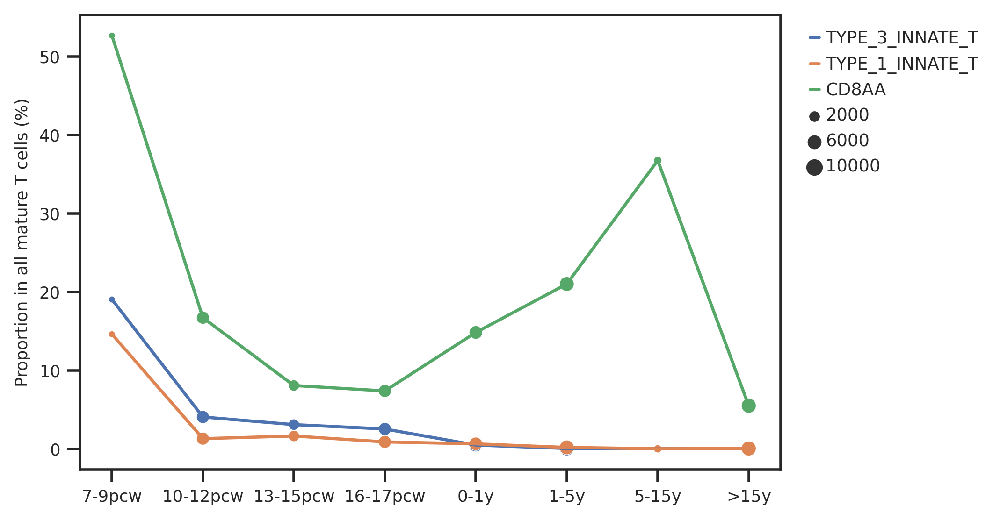

In [45]:
fig, ax = plt.subplots(figsize=(6,4))
g = sb.lineplot(data=cc4, x='age_bin', y='ct%',hue='ct')
s = sb.scatterplot(cc4.loc[:,'age_bin'], cc4.loc[:,'ct%'],hue=cc4.loc[:,'ct'],
                    size =np.array(cc4.loc[:,'total'], dtype='float'),
                   sizes=(10, 50))
s.set_ylabel('Proportion in all mature T cells (%)', fontsize=8)
s.set(xlabel='')
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
ax.xaxis.grid(False)
#s.legend(" ",bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='xx-small')
#s.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='xx-small')
h,l = ax.get_legend_handles_labels()
l1 = ax.legend(h[:3]+[h[-5]]+[h[-3]]+[h[-1]],l[:3]+[l[-5]]+[l[-3]]+[l[-1]], loc='upper left',bbox_to_anchor=(1.02, 1),frameon=False, fontsize='x-small')
plt.savefig(fig_path+'unconventionalT_jp_thymus.pdf',bbox_inches='tight')

# abTCR usage

In [60]:
# only take samples that had TCR sequencing done, and exclude CD137, MAIT sort
adata_abtcr = adata[adata.obs['file'].isin(meta_ab['GEX_id'])].copy()
adata_abtcr = adata_abtcr[~(adata_abtcr.obs['Sort_id'].isin(['CD137','MAIT']))]

In [61]:
# load TCR list by location
TCR_list_by_loc = []
TCR_list_by_loc_dict = {}
for chain in ['TRAV','TRAJ','TRBV','TRBD','TRBJ']:
    path = '/home/jovyan/gene_list/'+chain+'_list_by_location.csv'
    TCR_list_by_loc_dict[chain] = list(pd.read_csv(path, header=None)[0])
    TCR_list_by_loc = TCR_list_by_loc + TCR_list_by_loc_dict[chain]

In [62]:
# check all genes from adata are inside
TRAV_list = list(adata_abtcr.obs['ab_IR_VJ_1_v_gene'].cat.categories[:-1])
TRAJ_list = list(adata_abtcr.obs['ab_IR_VJ_1_j_gene'].cat.categories[:-1])
TRBV_list = list(adata_abtcr.obs['ab_IR_VDJ_1_v_gene'].cat.categories[:-1])
TRBD_list = list(adata_abtcr.obs['ab_IR_VDJ_1_d_gene'].cat.categories[:-1])
TRBJ_list = list(adata_abtcr.obs['ab_IR_VDJ_1_j_gene'].cat.categories[:-1])
TCR_list = TRAV_list+TRAJ_list+TRBV_list+TRBD_list+TRBJ_list

In [63]:
sum(~pd.Series(TCR_list).isin(TCR_list_by_loc))

0

### output TRA table for LR in R

In [64]:
ct_select =['TYPE_3_INNATE_T','TYPE_1_INNATE_T','CD8AA','CD4+T','TREG','CD8+T'] 

In [65]:
# make TRAV count table
TCR_chain = pd.DataFrame(columns = TCR_list_by_loc_dict['TRAV'],  index = ct_select)

In [66]:
for i in range(TCR_chain.shape[0]):
    cell = TCR_chain.index[i]
    counter = Counter(adata_abtcr.obs.loc[adata_abtcr.obs['anno_lvl_2_final_clean']==cell,'ab_IR_VJ_1_v_gene'])
    for chain_type in TCR_chain.columns:
        TCR_chain.loc[cell,chain_type] = counter[chain_type]

In [67]:
TRAV = TCR_chain
TRAV.to_csv('csv/TRAV.csv')

In [68]:
# make TRAJ count table
TCR_chain = pd.DataFrame(columns = TCR_list_by_loc_dict['TRAJ'],  index = ct_select)

In [69]:
for i in range(TCR_chain.shape[0]):
    cell = TCR_chain.index[i]
    counter = Counter(adata_abtcr.obs.loc[adata_abtcr.obs['anno_lvl_2_final_clean']==cell,'ab_IR_VJ_1_j_gene'])
    for chain_type in TCR_chain.columns:
        TCR_chain.loc[cell,chain_type] = counter[chain_type]

In [70]:
TRAJ = TCR_chain
TRAJ.to_csv('csv/TRAJ.csv')

### heatmap plotting

In [122]:
ct_select =['DN(P)_T','DN(Q)_T','DP(P)_T','DP(Q)_T','TYPE_1_INNATE_T','TYPE_3_INNATE_T','CD8AA','CD4+T','TREG','CD8+T'] # for beta chain
#ct_select =['DP(P)_T','DP(Q)_T','TYPE_1_INNATE_T','TYPE_3_INNATE_T','CD8AA','CD4+T','TREG','CD8+T'] # for alpha chain
TCR_chain = pd.DataFrame(columns = TCR_list_by_loc_dict['TRBJ'],  index = ct_select)

In [123]:
for i in range(TCR_chain.shape[0]):
    cell = TCR_chain.index[i]
    counter = Counter(adata_abtcr.obs.loc[adata_abtcr.obs['anno_lvl_2_final_clean']==cell,'ab_IR_VDJ_1_j_gene'])
    for chain_type in TCR_chain.columns:
        TCR_chain.loc[cell,chain_type] = counter[chain_type]
        
    TCR_chain.loc[cell,:] = TCR_chain.loc[cell,:] / np.sum(TCR_chain.loc[cell,:]) * 100

In [124]:
TCR_chain.columns = [a.replace('TR','') for a in TCR_chain.columns]

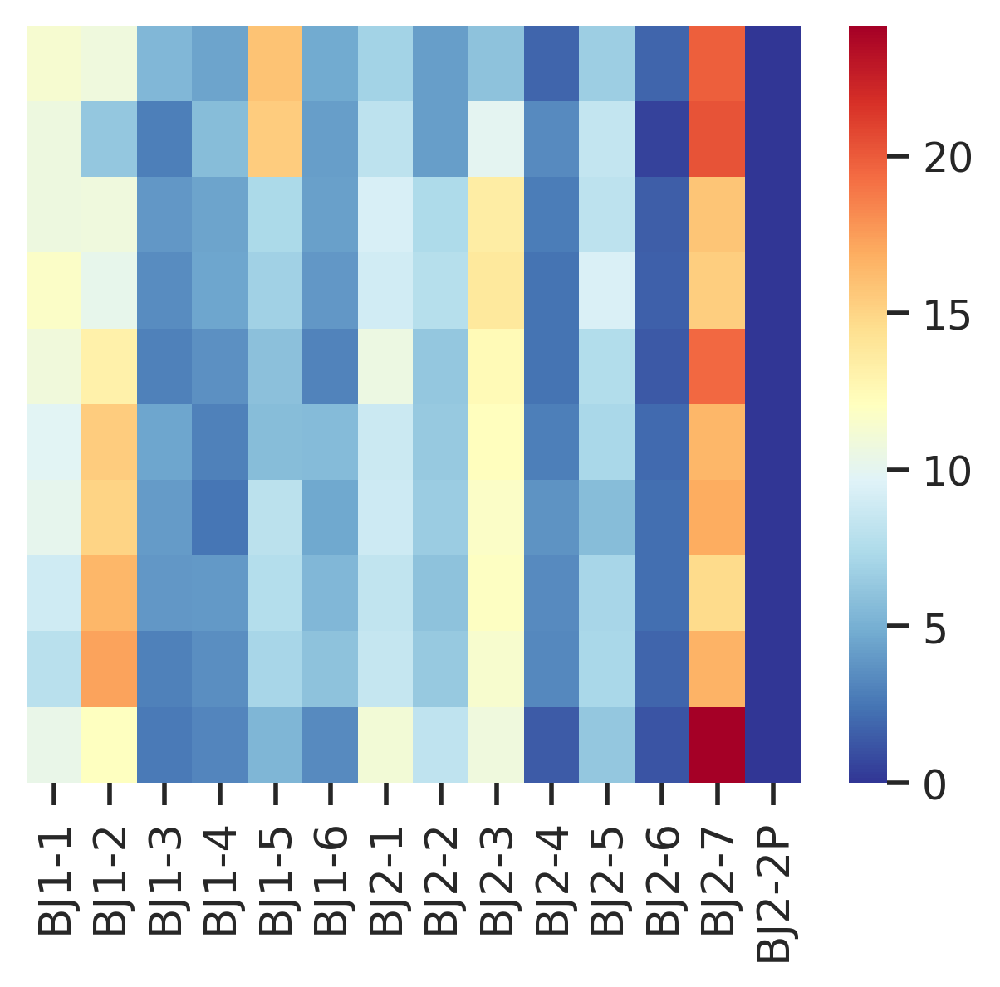

In [125]:
fig, ax = plt.subplots(figsize=(TCR_chain.shape[1]/3,TCR_chain.shape[0]*0.375))
#sb.set_theme()
uniform_data = TCR_chain
uniform_data=uniform_data.astype('float')
ax = sb.heatmap(uniform_data,cmap='RdYlBu_r')
_, xlabels = plt.xticks()
_, ylabels = plt.yticks()
ax.set_xticklabels(xlabels, size=12,rotation=90)
ax.set_yticklabels(ylabels, size=12,rotation=0)

ax.axes.get_yaxis().set_visible(False) # remove y axis tick and label
plt.savefig(fig_path+'TCR_TRBJ.pdf',bbox_inches='tight');

### test difference in TRAV and TRAJ usage in unconventional vs conventional with LR

In [91]:
%load_ext rpy2.ipython

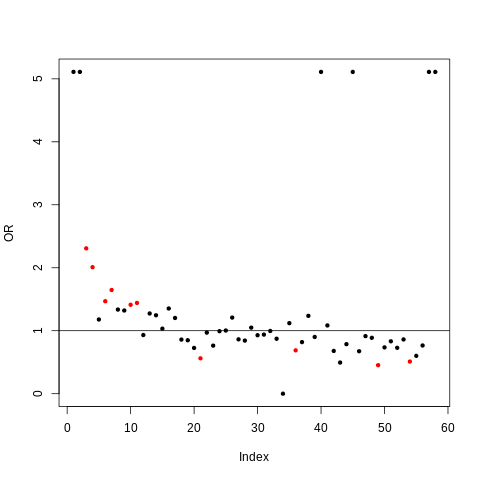

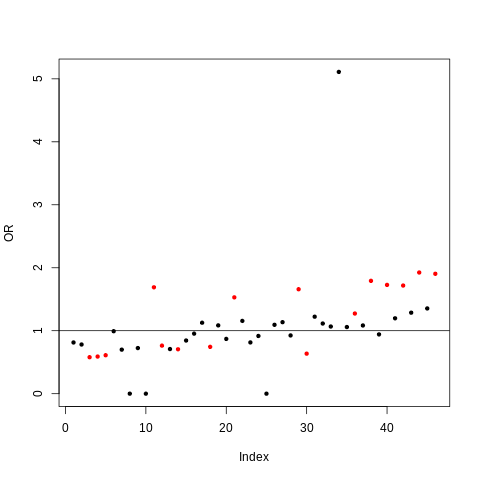

In [92]:
%%R
###### group unconventional cells and conventional cells, then do LR ######
cell_type <- rep(c('unconv', 'conv'), c(3,3))
cell <- c('TYPE_1_INNATE_T','TYPE_3_INNATE_T','CD8AA', 'CD4T', 'TREG', 'CD8T')

####### traj #######
traj = read.csv('csv/TRAJ.csv', row.names=1)
tot <- rowSums(traj)
OR <- pval <- rep(0, ncol(traj))  # OR is unconventional / conventional
for (j in 1:ncol(traj)){
  dat <- data.frame(tot=tot, gene_usage=traj[, j], type=cell_type, cell=cell)
  ret <- glm(cbind(gene_usage, tot-gene_usage) ~ type, data=dat[dat$cell %in% c('TYPE_1_INNATE_T','CD8T','CD8AA','TYPE_3_INNATE_T','CD4T','TREG'),], family=binomial)
  tmp <- coef(summary(ret))
  OR[j] <- exp(tmp[2, 1])
  pval[j] <- tmp[2, 4]
}

p.adj <- p.adjust(pval, method='BH')
plot(OR, col=ifelse(p.adj < 0.1, 'red', 'black'), pch=20)
abline(h=1)
traj_out <- data.frame(TR=colnames(traj), OR=OR, p.adj=p.adj)
traj_out[traj_out$p.adj < 0.1, ]


####### trav #######
trav = read.csv('csv/TRAV.csv', row.names=1)
tot <- rowSums(trav)
OR <- pval <- rep(0, ncol(trav))  # OR is unconventional / conventional
for (j in 1:ncol(trav)){
  dat <- data.frame(tot=tot, gene_usage=trav[, j], type=cell_type, cell=cell)
  ret <- glm(cbind(gene_usage, tot-gene_usage) ~ type, data=dat[dat$cell %in% c('TYPE_1_INNATE_T','CD8T','CD8AA','TYPE_3_INNATE_T','CD4T','TREG'),], family=binomial)
  tmp <- coef(summary(ret))
  OR[j] <- exp(tmp[2, 1])
  pval[j] <- tmp[2, 4]
}

p.adj <- p.adjust(pval, method='BH')
plot(OR, col=ifelse(p.adj < 0.1, 'red', 'black'), pch=20)
#text(seq_along(OR), OR, labels=round(p.adjust(pval, method='BH'),3), cex=0.8, pos=1)
abline(h=1)
trav_out <- data.frame(TR=colnames(trav), OR=OR, p.adj=p.adj)
trav_out[trav_out$p.adj < 0.1, ]

out <- rbind(traj_out, trav_out)
out$direction <- ifelse(out$OR > 1, 'unconv', 'conv')
write.csv(out[out$p.adj < 0.1, ], file='csv/tra_logistic_signficant.csv')

### use all TCR information for PCA plotting

In [87]:
bdata = adata_abtcr[adata_abtcr.obs['anno_lvl_2_final_clean'].isin(['DP(P)_T','DP(Q)_T','CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'])]

In [88]:
bdata = bdata[bdata.obs['ab_chain_pairing'].isin(['single pair','extra VJ','extra VDJ','two full chains'])]

In [89]:
#write csv for chi-square test
bdata.obs.to_csv('csv/TCR_VDJ_usage.csv') 

In [90]:
bdata.obs['smp_celltype'] = bdata.obs['Sample'].astype('string') +'_'+ bdata.obs['anno_lvl_2_final_clean'].astype('string')

Trying to set attribute `.obs` of view, copying.


In [91]:
df1 = pd.DataFrame({'smp_celltype': Counter(bdata.obs['smp_celltype']).keys(),
                  'cellcount': Counter(bdata.obs['smp_celltype']).values()})

In [92]:
new_list = df1.loc[df1['cellcount']>20,'smp_celltype'] # smp_celltype of at least 20 cells 

In [93]:
TCR_list = TRAV_list+TRAJ_list+TRBV_list+TRBJ_list

In [94]:
TCR = pd.DataFrame(columns = TCR_list, index = new_list)

In [95]:
for i in range(TCR.shape[0]):
    cell = TCR.index[i]
    counter1 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'ab_IR_VJ_1_v_gene'])
    for TRAV in TRAV_list:
        TCR.loc[cell,TRAV] = counter1[TRAV]
    
    counter2 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'ab_IR_VJ_1_j_gene'])
    for TRAJ in TRAJ_list:
        TCR.loc[cell,TRAJ] = counter2[TRAJ]
    
    counter3 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'ab_IR_VDJ_1_v_gene'])
    for TRBV in TRBV_list:
        TCR.loc[cell,TRBV] = counter3[TRBV]
        
    #counter4 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'ab_IR_VDJ_1_v_gene'])
    #for TRBD in TRBD_list:
        #TCR.loc[cell,TRBD] = counter3[TRBD]
        
    counter5 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'ab_IR_VDJ_1_j_gene'])
    for TRBJ in TRBJ_list:
        TCR.loc[cell,TRBJ] = counter5[TRBJ]
        
    #counter6 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'IR_VDJ_1_c_gene'])
    #for TRBC in TRBC_list:
        #TCR.loc[cell,TRBC] = counter6[TRBC]
        
    # normalise  
    TCR.loc[cell,TCR.columns.isin(TRAV_list)] = TCR.loc[cell,TCR.columns.isin(TRAV_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRAV_list)]) * 100 
    TCR.loc[cell,TCR.columns.isin(TRAJ_list)] = TCR.loc[cell,TCR.columns.isin(TRAJ_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRAJ_list)]) * 100
    TCR.loc[cell,TCR.columns.isin(TRBV_list)] = TCR.loc[cell,TCR.columns.isin(TRBV_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRBV_list)]) * 100
    #TCR.loc[cell,TCR.columns.isin(TRBD_list)] = TCR.loc[cell,TCR.columns.isin(TRBD_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRBD_list)]) * 100 
    TCR.loc[cell,TCR.columns.isin(TRBJ_list)] = TCR.loc[cell,TCR.columns.isin(TRBJ_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRBJ_list)]) * 100
    #TCR.loc[cell,TCR.columns.isin(TRBC_list)] = TCR.loc[cell,TCR.columns.isin(TRBC_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRBC_list)]) * 100

In [96]:
df2 = pd.DataFrame(index = TCR.index, columns=['cell_type'])
df2['cell_type'] = list(TCR.index)

In [97]:
TCR_adata = sc.AnnData(X =np.array(TCR), obs = df2, var = list(TCR.columns))

In [98]:
sc.pp.pca(TCR_adata, n_comps = 30, use_highly_variable = False, svd_solver = 'arpack', random_state = 1712)
#sc.pp.neighbors(TCR_adata)
#sc.tl.umap(TCR_adata, random_state = 1712)

In [99]:
TCR_adata.obs['cell_type']=TCR_adata.obs['cell_type'].astype('category')
TCR_adata.obs['cell_count']=lookup(TCR_adata.obs['cell_type'], df1,'smp_celltype','cellcount')
TCR_adata.obs['organ'] = lookup(TCR_adata.obs_names, bdata.obs, 'smp_celltype','organ')
TCR_adata.obs['age'] = lookup(TCR_adata.obs_names, bdata.obs, 'smp_celltype','age')
TCR_adata.obs['donor'] = lookup(TCR_adata.obs_names, bdata.obs, 'smp_celltype','donor')
TCR_adata.obs['cell_type'] = lookup(TCR_adata.obs['cell_type'], bdata.obs,'smp_celltype','anno_lvl_2_final_clean')

In [100]:
PCA = TCR_adata.obsm['X_pca'][:,range(2)]

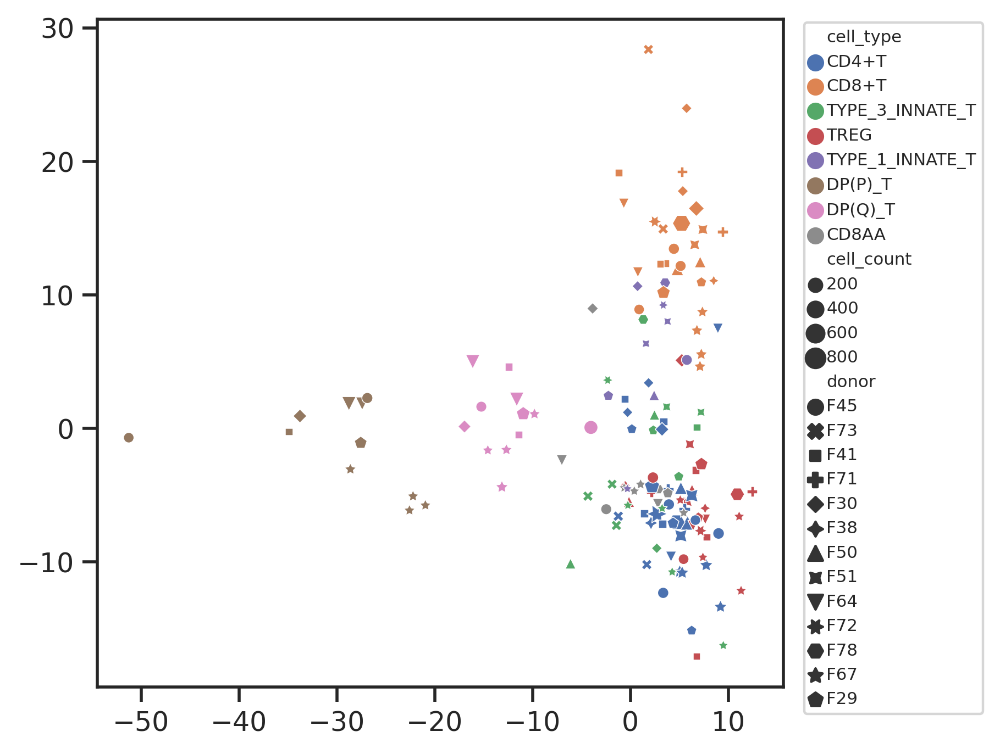

In [101]:
sb.set_theme(style='ticks')
fig, ax = plt.subplots(figsize=(5,5))
sb.scatterplot(x=-PCA[:,0],y=PCA[:,1], hue=TCR_adata.obs['cell_type'],size = TCR_adata.obs['cell_count'],style=TCR_adata.obs['donor'])
ax.legend(bbox_to_anchor=(1.03, 0.995), loc=2, borderaxespad=0.,fontsize='xx-small')
#plt.savefig('figures/TCR_PCA.pdf');

In [102]:
ct_list = ['DP(P)_T','DP(Q)_T','TYPE_1_INNATE_T','CD8AA','TYPE_3_INNATE_T','CD4+T','TREG', 'CD8+T']
df = pd.DataFrame({'PC1':-PCA[:,0],
                   'PC2':PCA[:,1],
                   'ct':TCR_adata.obs['cell_type'],
                   'cell_n': TCR_adata.obs['cell_count']
})
df['ct']=df['ct'].astype('category')
df['ct']=df['ct'].cat.reorder_categories(ct_list)

In [103]:
import sklearn 
pca = sklearn.decomposition.PCA(n_components =2)

def ct_centroid_dist(TCR):
    pc = pca.fit_transform(TCR)
    ct_centroid = pd.DataFrame(index=ct_list,
                               columns = ['PC1','PC2'])
    for ct in ct_list:
        tf = TCR_adata.obs['cell_type']==ct
        pc_ct = pc[tf,:]
        weights = np.ones(np.sum(tf))#np.array(TCR_adata.obs.loc[tf,'cell_count'])
        ct_centroid.loc[ct, :] = np.sum(pc_ct.T * weights, axis = 1) / np.sum(weights)
    ct_dist = pd.DataFrame(sp.spatial.distance.cdist(ct_centroid, ct_centroid), index = ct_list, columns = ct_list)
    return ct_dist, ct_centroid

In [104]:
ct_dist,ct_centroid=ct_centroid_dist(TCR)

In [105]:
ct_centroid.iloc[:,0]

DP(P)_T              29.536
DP(Q)_T               12.41
TYPE_1_INNATE_T    -2.07197
CD8AA             -0.236777
TYPE_3_INNATE_T    -1.88761
CD4+T              -4.07561
TREG               -6.46986
CD8+T              -4.82197
Name: PC1, dtype: object

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/seaborn/distributions.py:1657: FutureWarning: The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.5 for `bw_method`, but please see the docs for the new parameters and update your code.
  warnings.warn(msg, FutureWarning)


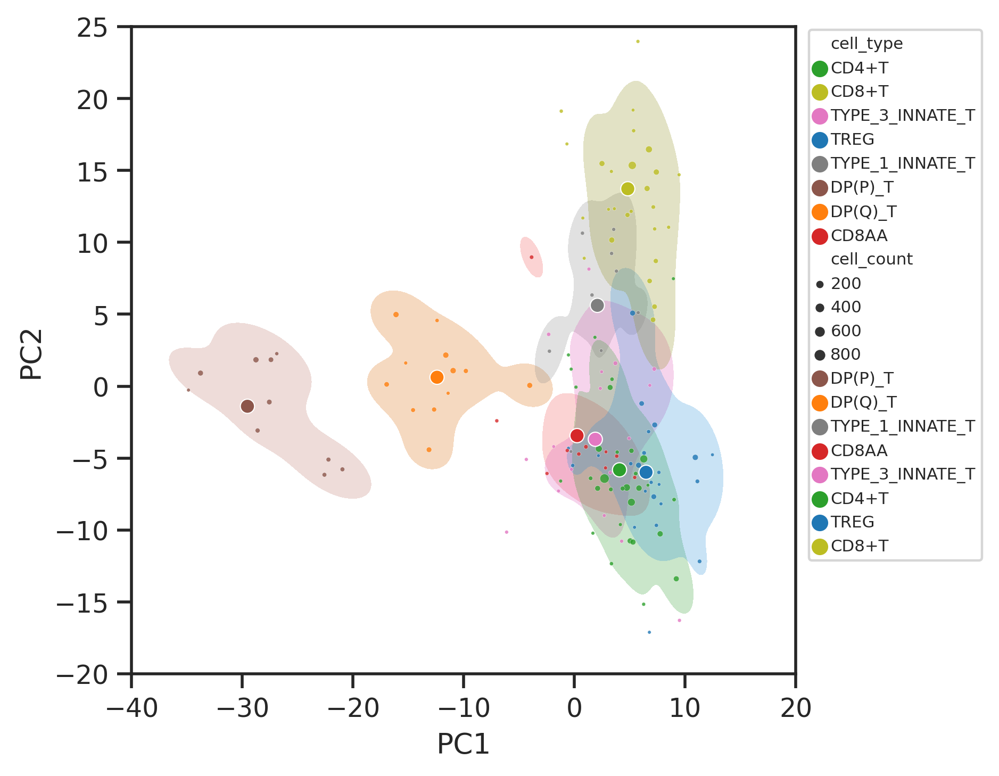

In [106]:
sb.set_theme(style='ticks')
color_order = np.array([5, 1, 7, 3, 6, 2, 0, 8])
ct_color_map = dict(zip(ct_list, np.array(sb.color_palette('tab10'))[color_order]))

fig, ax = plt.subplots(figsize=(5,5))
#plt.rcParams["figure.figsize"] = (5,5)
sb.kdeplot(data=df, x="PC1", y="PC2", hue="ct", fill=True,weights='cell_n',alpha=0.25,levels=[0.2,1],bw=0.5,palette=ct_color_map)
sb.scatterplot(x=-PCA[:,0],y=PCA[:,1], hue=TCR_adata.obs['cell_type'],
               palette=ct_color_map,size = TCR_adata.obs['cell_count'],sizes=(2,15),alpha=0.8)
sb.scatterplot(x=-ct_centroid.iloc[:,0],y=ct_centroid.iloc[:,1], hue=ct_centroid.index,palette=ct_color_map)

ax.set_ylim(-20,25)
ax.set_xlim(-40,20)
ax.legend(bbox_to_anchor=(1.02, 0.995), loc=2, borderaxespad=0.,fontsize='xx-small')
plt.savefig(fig_path+'TCR_PCA_centroid.pdf',bbox_inches='tight');

# gdTCR usage

In [46]:
# only leave samples that have gdTCR done, and no MAIT, CD137 sorting - adata_gdtcr
adata_gdtcr = adata[adata.obs['file'].isin(meta_gd['GEX file'])].copy() 
#adata_tcr = adata_tcr[adata_tcr.obs['file'].isin(meta_ab['GEX_id'])].copy()
adata_gdtcr = adata_gdtcr[~(adata_gdtcr.obs['Sort_id'].isin(['CD137','MAIT']))]

In [47]:
# only leave T cells
a = adata_gdtcr.obs['anno_lvl_2_final_clean'].isin(['CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'])
gdT = adata_gdtcr[a].copy()

In [48]:
a = np.array(gdT.obsm['X_umap'][:,0]>-3) & np.array(gdT.obsm['X_umap'][:,0]<8) & np.array(gdT.obsm['X_umap'][:,1]>-2)
gdT_plot = gdT[a].copy()

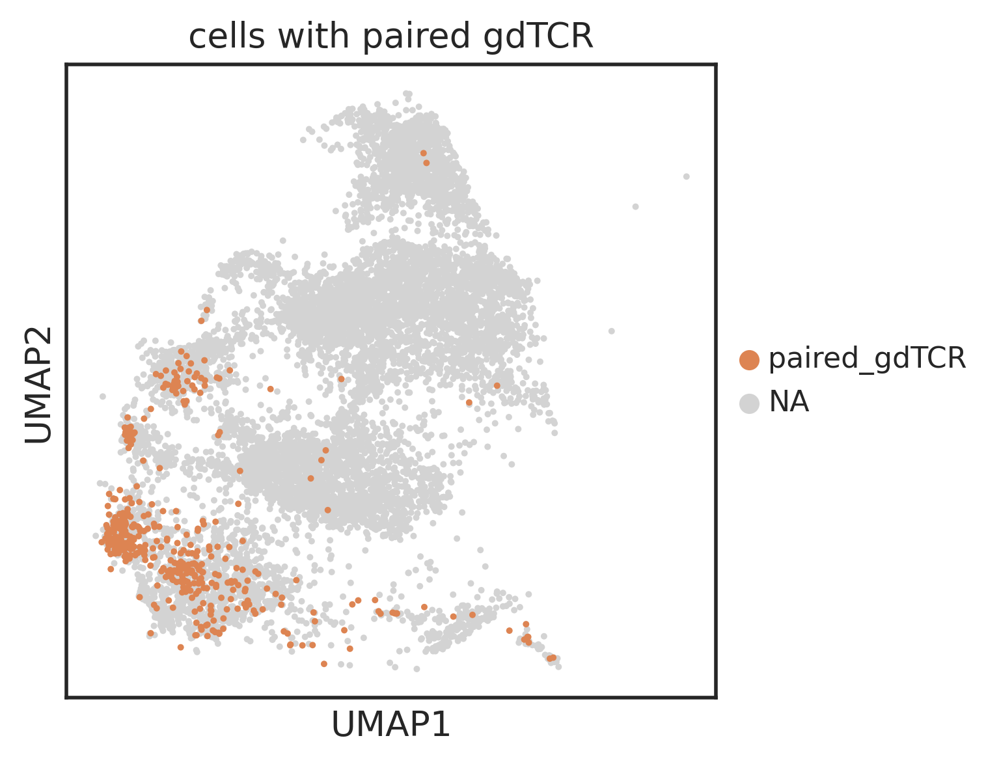

In [49]:
plt.rcParams["figure.figsize"] = [4,4]
sc.pl.umap(gdT_plot, color=['gdTCR'], groups=['paired_gdTCR'],title='cells with paired gdTCR',
           legend_fontsize=10,size=20,save='gdT.pdf')

In [50]:
# restrict data to samples that only have both abTCR and gdTCR sequenced - gdT_select
gdT_select = gdT[gdT.obs['file'].isin(meta_ab['GEX_id'])].copy()

In [51]:
a = list(gdT_select.obs['gdTCR']=='paired_gdTCR')
b = list(gdT_select.obs['abTCR']=='paired_abTCR')
c = list(~(gdT_select.obs['gdTCR']=='paired_gdTCR'))
d = list(~(gdT_select.obs['abTCR']=='paired_abTCR'))
dp = [x and y for x,y in zip(a,b)]
dn = [x and y for x,y in zip(c,d)]
gd = [x and y for x,y in zip(a,d)]
ab = [x and y for x,y in zip(b,c)]

In [52]:
gdT_select.obs.loc[dp,'TCR_combine']= 'both'
gdT_select.obs.loc[dn,'TCR_combine']= 'neither'
gdT_select.obs.loc[gd,'TCR_combine']= 'paired gdTCR'
gdT_select.obs.loc[ab,'TCR_combine']= 'paired abTCR'

... storing 'TCR_combine' as categorical


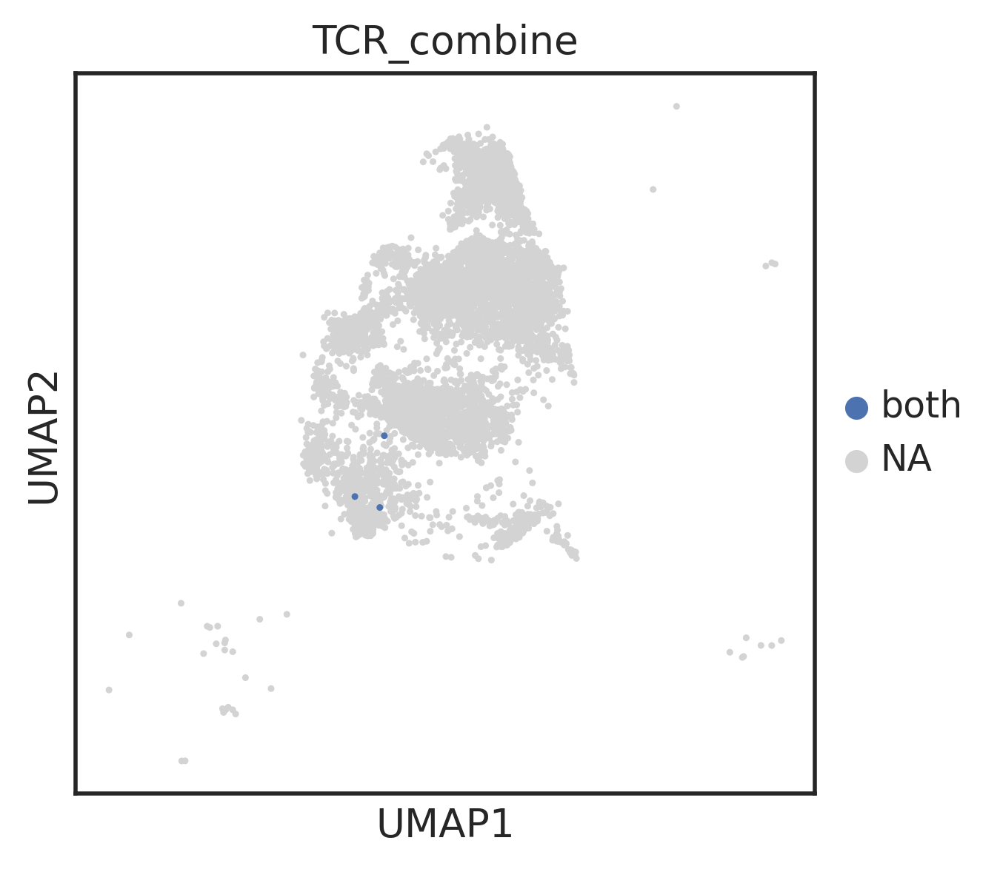

In [53]:
sc.pl.umap(gdT_select, color=['TCR_combine'],groups=['both'])

In [54]:
gdT_select.obs['TCR_combine'] = gdT_select.obs['TCR_combine'].cat.reorder_categories(['paired abTCR', 'paired gdTCR','both','neither'])

In [55]:
df = pd.DataFrame(index = ['CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'], columns = gdT_select.obs['TCR_combine'].cat.categories)
for ct in df.index:
    counter = Counter(gdT_select[gdT_select.obs['anno_lvl_2_final_clean']==ct].obs['TCR_combine'])
    for cat in df.columns:
        df.loc[ct, cat]=counter[cat]

In [56]:
sm = np.array(np.sum(df,axis=1)).reshape(df.shape[0],1)
df1=df / sm * 100
df1['ct']=df.index

In [57]:
df

,paired abTCR,paired gdTCR,both,neither
CD8+T,1223,8,1,283
CD4+T,2437,0,0,495
TREG,1055,2,0,177
CD8AA,162,25,0,97
TYPE_3_INNATE_T,372,49,0,106
TYPE_1_INNATE_T,292,145,2,348


In [58]:
df1

,paired abTCR,paired gdTCR,both,neither,ct
CD8+T,80.7261,0.528053,0.0660066,18.6799,CD8+T
CD4+T,83.1173,0,0,16.8827,CD4+T
TREG,85.4943,0.162075,0,14.3436,TREG
CD8AA,57.0423,8.80282,0,34.1549,CD8AA
TYPE_3_INNATE_T,70.5882,9.29791,0,20.1139,TYPE_3_INNATE_T
TYPE_1_INNATE_T,37.1029,18.4244,0.25413,44.2186,TYPE_1_INNATE_T


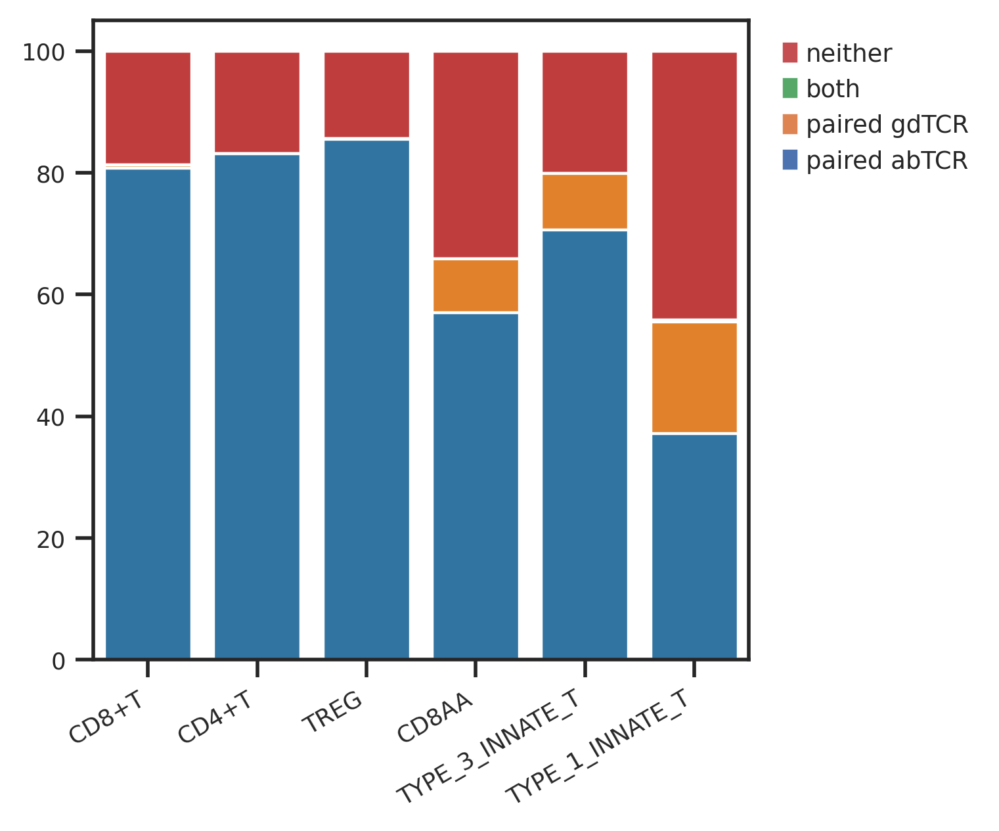

In [59]:
sb.set_theme(style='ticks')
fig, ax = plt.subplots(figsize=(4,4))
legend = []

for i in range(4)[::-1]:
    bar = sb.barplot(x='ct',  y=np.sum(df1.iloc[:,0:i+1],axis=1), data=df1, color=sb.color_palette('tab10')[i])
    legend = legend+[mpatches.Patch(color=sb.color_palette()[i], label=df1.columns[i])]
plt.xticks(fontsize=8,rotation=30,horizontalalignment='right')
plt.yticks(fontsize=8)
ax.set_xlabel('')
#ax.set_ylabel('Proportion of scVDJseq cells (%)')

# add legend
ax.legend(handles=legend,loc='upper left',bbox_to_anchor=(1.02, 1),frameon=False, fontsize='x-small')

plt.savefig(fig_path+'gdT.pdf',bbox_inches='tight');

### What's in neither category

In [107]:
no_tcr = gdT_select[gdT_select.obs['TCR_combine']=='neither']

In [110]:
Counter(no_tcr.obs['ab_chain_pairing'])

Counter({'orphan VDJ': 756, 'no IR': 630, 'orphan VJ': 120})

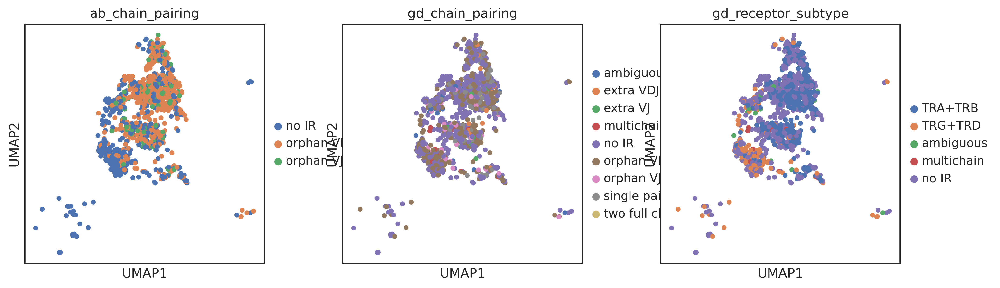

In [111]:
sc.pl.umap(no_tcr, color=['ab_chain_pairing','gd_chain_pairing','gd_receptor_subtype'])

In [112]:
Counter(no_tcr[no_tcr.obs['gd_receptor_subtype']=='TRG+TRD'].obs['gd_chain_pairing']) # so all TRG+TRD cells are either orphal VDJ or orphan VJ

Counter({'orphan VDJ': 167, 'orphan VJ': 37})

In [113]:
ab = no_tcr.obs['ab_chain_pairing'].isin(['orphan VDJ','orphan VJ'])
gd = no_tcr.obs['gd_receptor_subtype']=='TRG+TRD'
a = list(ab)
b = list(gd)
c = list(~ab)
d = list(~gd)
dp = [x and y for x,y in zip(a,b)]
dn = [x and y for x,y in zip(c,d)]
ab = [x and y for x,y in zip(a,d)]
gd = [x and y for x,y in zip(b,c)]

In [114]:
no_tcr.obs.loc[dp,'TCR_orphan_chain']= 'both'
no_tcr.obs.loc[dn,'TCR_orphan_chain']= 'neither'
no_tcr.obs.loc[gd,'TCR_orphan_chain']= 'orphan gdTCR'
no_tcr.obs.loc[ab,'TCR_orphan_chain']= 'orphan abTCR'

... storing 'TCR_orphan_chain' as categorical


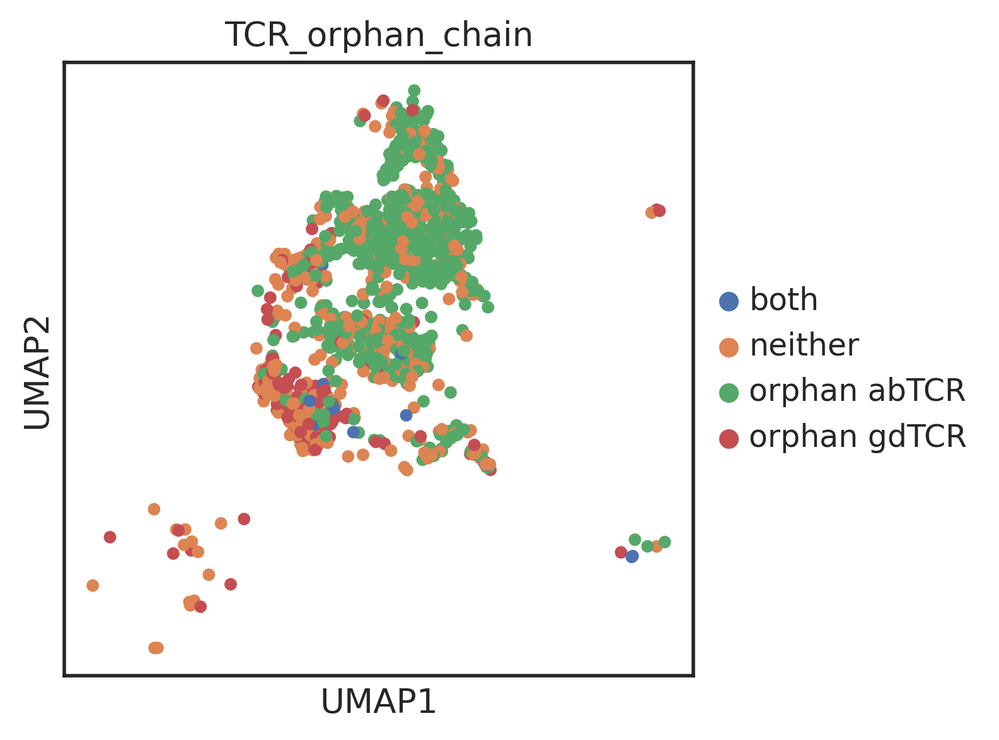

In [115]:
sc.pl.umap(no_tcr, color=['TCR_orphan_chain'])

In [116]:
no_tcr.obs['TCR_orphan_chain'] = no_tcr.obs['TCR_orphan_chain'].cat.reorder_categories(['orphan abTCR', 'orphan gdTCR','both','neither'])

In [117]:
df = pd.DataFrame(index = ['CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'], columns = no_tcr.obs['TCR_orphan_chain'].cat.categories)
for ct in df.index:
    counter = Counter(no_tcr[no_tcr.obs['anno_lvl_2_final_clean']==ct].obs['TCR_orphan_chain'])
    for cat in df.columns:
        df.loc[ct, cat]=counter[cat]

In [118]:
sm = np.array(np.sum(df,axis=1)).reshape(df.shape[0],1)
df1=df / sm * 100
df1['ct']=df.index

In [119]:
df1

,orphan abTCR,orphan gdTCR,both,neither,ct
CD8+T,69.9647,2.4735,0.706714,26.8551,CD8+T
CD4+T,81.8182,0.40404,0,17.7778,CD4+T
TREG,77.4011,1.12994,0.564972,20.904,TREG
CD8AA,38.1443,17.5258,6.18557,38.1443,CD8AA
TYPE_3_INNATE_T,30.1887,27.3585,3.77358,38.6792,TYPE_3_INNATE_T
TYPE_1_INNATE_T,12.069,35.0575,3.44828,49.4253,TYPE_1_INNATE_T


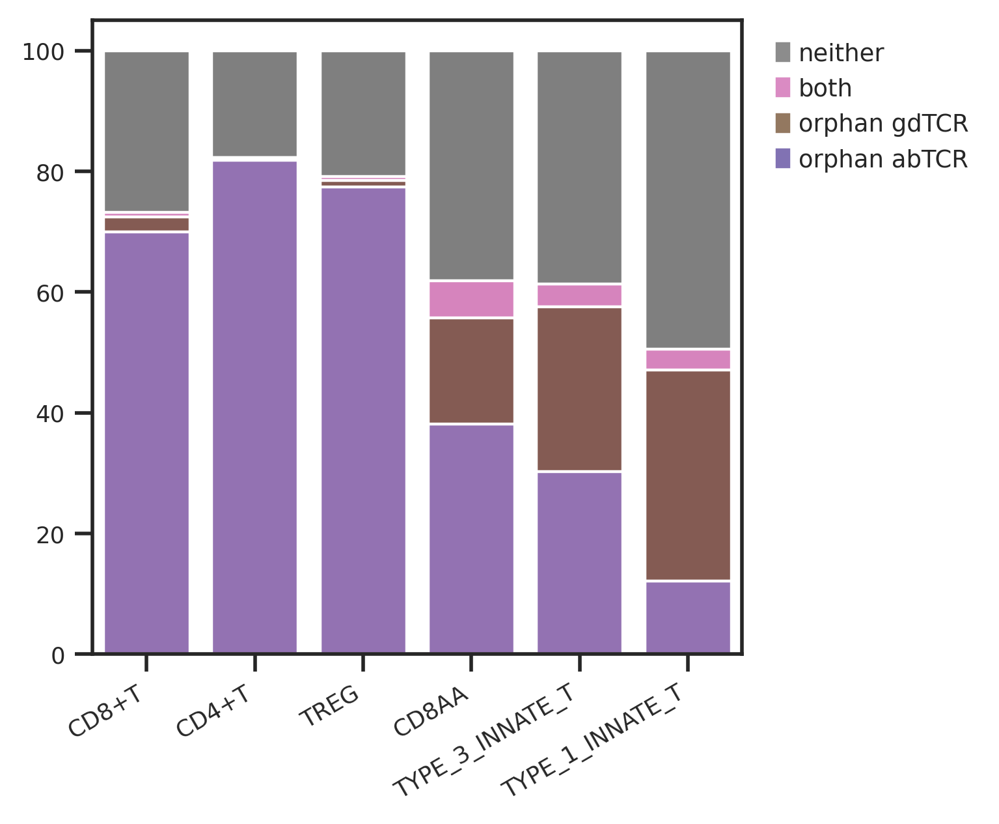

In [120]:
sb.set_theme(style='ticks')
fig, ax = plt.subplots(figsize=(4,4))
legend = []

for i in range(4)[::-1]:
    bar = sb.barplot(x='ct',  y=np.sum(df1.iloc[:,0:i+1],axis=1), data=df1, color=sb.color_palette('tab10')[i+4])
    legend = legend+[mpatches.Patch(color=sb.color_palette()[i+4], label=df1.columns[i])]
plt.xticks(fontsize=8,rotation=30,horizontalalignment='right')
plt.yticks(fontsize=8)
ax.set_xlabel('')

# add legend
ax.legend(handles=legend,loc='upper left',bbox_to_anchor=(1.02, 1),frameon=False, fontsize='x-small')

plt.savefig(fig_path+'TCR_no_chain.pdf',bbox_inches='tight');

### difference btw gdT and abT in CD8AA, TH17, NKT

In [121]:
# NKT
ct = ['TYPE_1_INNATE_T']
a = list(gdT_select.obs['anno_lvl_2_final_clean'].isin(ct))
b = list(gdT_select.obs['TCR_combine'].isin(['paired abTCR','paired gdTCR']))
mask = [a and b for a,b in zip(a,b)]
gdT_select_ct = gdT_select[mask]
sc.tl.rank_genes_groups(gdT_select_ct, 'TCR_combine', method = 'wilcoxon', use_raw = True)
result = gdT_select_ct.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_clusters = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})
wilcox_clusters.head(10)

Trying to set attribute `.uns` of view, copying.


,paired abTCR_n,paired abTCR_l,paired abTCR_p,paired gdTCR_n,paired gdTCR_l,paired gdTCR_p
0,CD8A,2.490979,5.071712e-13,TRDV2,10.546144,2.498520e-45
1,CD8B,4.265725,2.406502e-09,TRDC,6.830760,2.102477e-30
2,CD2,2.549196,4.355446e-08,TRGV9,3.534557,3.767135e-16
3,IL7R,1.924914,1.321487e-05,NKG7,1.015714,5.395618e-07
4,B2M,0.295972,1.868208e-03,RPLP0,0.443655,1.240153e-06
5,ISG20,1.438288,2.400639e-03,RPLP1,0.337718,3.613290e-06
6,LEPROTL1,1.347176,2.600020e-03,CCL4,2.268858,2.864132e-04
7,TRAC,1.560852,2.860376e-03,RPS29,0.474417,1.055661e-03
8,SARAF,0.504242,5.471736e-03,EEF1A1,0.205345,2.860376e-03
9,CAMK4,1.308260,1.151470e-02,RPLP2,0.279878,3.230185e-03


In [122]:
print(sum(wilcox_clusters['paired abTCR_p'] < 0.05)) # only 9 significant results 
NKT_sig = list(wilcox_clusters.loc[wilcox_clusters['paired abTCR_p'] < 0.05, 'paired abTCR_n'])

38


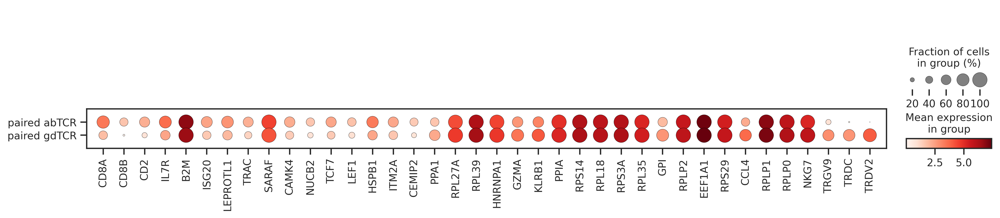

In [123]:
sc.pl.dotplot(gdT_select_ct, var_names=NKT_sig,groupby='TCR_combine',save = 'TYPE_1_INNATE_T_gd_ab_comparison.pdf')

In [124]:
ct = ['TYPE_3_INNATE_T']
a = list(gdT_select.obs['anno_lvl_2_final_clean'].isin(ct))
b = list(gdT_select.obs['TCR_combine'].isin(['paired abTCR','paired gdTCR']))
mask = [a and b for a,b in zip(a,b)]
gdT_select_ct = gdT_select[mask]
sc.tl.rank_genes_groups(gdT_select_ct, 'TCR_combine', method = 'wilcoxon', use_raw = True)
result = gdT_select_ct.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_clusters = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})
wilcox_clusters.head(10)

Trying to set attribute `.uns` of view, copying.


,paired abTCR_n,paired abTCR_l,paired abTCR_p,paired gdTCR_n,paired gdTCR_l,paired gdTCR_p
0,TRAC,1.445468,0.045715,TRDV2,9.940006,1.108533e-24
1,B2M,0.336246,0.045715,TRDC,8.579231,2.215314e-20
2,TRAT1,1.415005,0.337763,TRGV9,5.074514,1.659237e-10
3,CYTIP,1.067629,0.391191,CD247,1.826876,1.728132e-04
4,RPL13,0.228806,0.408142,ZBTB16,2.044748,5.663338e-03
5,GPR183,2.206674,0.408142,RPLP0,0.335586,1.436437e-02
6,SARAF,0.516360,0.524382,PPIA,0.449090,4.571524e-02
7,RPL8,0.377953,0.602348,NKG7,2.271033,3.047551e-01
8,CAMK4,1.530675,0.674958,NPM1,0.481091,4.081424e-01
9,TPT1,0.258142,0.777722,LSP1,0.867888,6.023477e-01


In [125]:
print(sum(wilcox_clusters['paired abTCR_p'] < 0.05)) # only 9 significant results 
TH17_sig = list(wilcox_clusters.loc[wilcox_clusters['paired abTCR_p'] < 0.05, 'paired abTCR_n'])

9


In [126]:
[gene for gene in TH17_sig if gene in NKT_sig]

['TRAC', 'B2M', 'PPIA', 'RPLP0', 'TRGV9', 'TRDC', 'TRDV2']

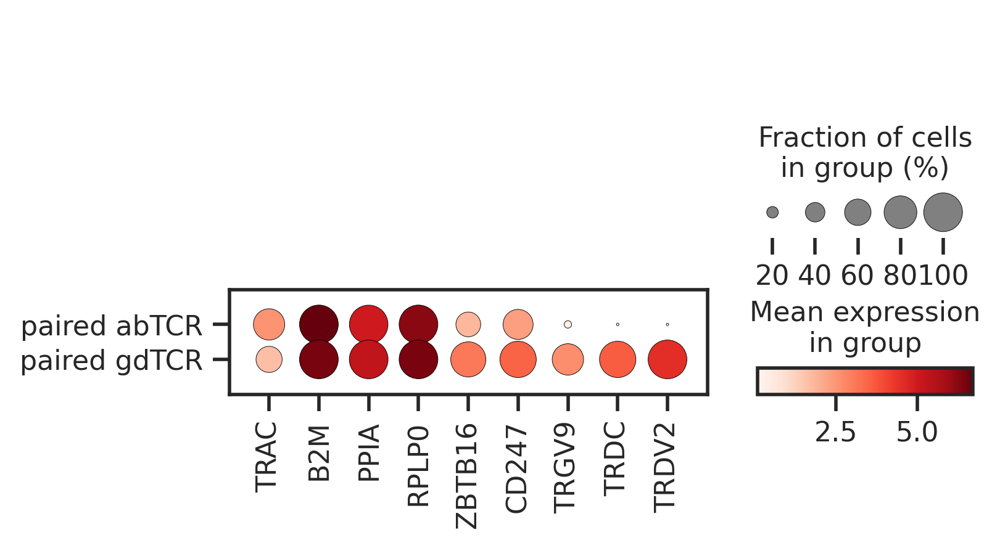

In [127]:
sc.pl.dotplot(gdT_select_ct, var_names=TH17_sig,groupby='TCR_combine',save = 'TYPE_3_INNATE_T_gd_ab_comparison.pdf')

In [128]:
ct = ['CD8AA']
a = list(gdT_select.obs['anno_lvl_2_final_clean'].isin(ct))
b = list(gdT_select.obs['TCR_combine'].isin(['paired abTCR','paired gdTCR']))
mask = [a and b for a,b in zip(a,b)]
gdT_select_ct = gdT_select[mask]
sc.tl.rank_genes_groups(gdT_select_ct, 'TCR_combine', method = 'wilcoxon', use_raw = True)
result = gdT_select_ct.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_clusters = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})
wilcox_clusters.head(10)

Trying to set attribute `.uns` of view, copying.


,paired abTCR_n,paired abTCR_l,paired abTCR_p,paired gdTCR_n,paired gdTCR_l,paired gdTCR_p
0,CD8A,6.066181,6.884379e-08,TRDC,6.462372,6.884379e-08
1,NUCB2,3.103965,2.028356e-05,TRDV2,9.675993,1.360578e-05
2,SOD1,2.007745,3.013737e-02,LSP1,3.384499,3.678600e-04
3,TRAC,1.665343,4.631730e-02,RPL39,0.757615,1.266158e-02
4,PTMA,0.707867,4.631730e-02,HINT1,1.312094,3.013737e-02
5,ITM2C,1.344350,9.170242e-02,RPS23,0.657287,3.772471e-02
6,CAMK4,2.016360,1.101402e-01,IFITM1,3.252839,3.772471e-02
7,TIAM1,2.575364,1.578786e-01,RPS21,0.828307,3.772471e-02
8,MT-ATP6,0.527461,2.944222e-01,IL32,3.004645,4.494229e-02
9,DAZAP2,0.995729,3.467656e-01,RPL38,0.995223,4.631730e-02


In [129]:
print(sum(wilcox_clusters['paired abTCR_p'] < 0.05)) # only 9 significant results 
CD8AA_sig = list(wilcox_clusters.loc[wilcox_clusters['paired abTCR_p'] < 0.05, 'paired abTCR_n'])

18


In [130]:
[gene for gene in CD8AA_sig if gene in NKT_sig]

['CD8A', 'NUCB2', 'TRAC', 'RPL39', 'TRDV2', 'TRDC']

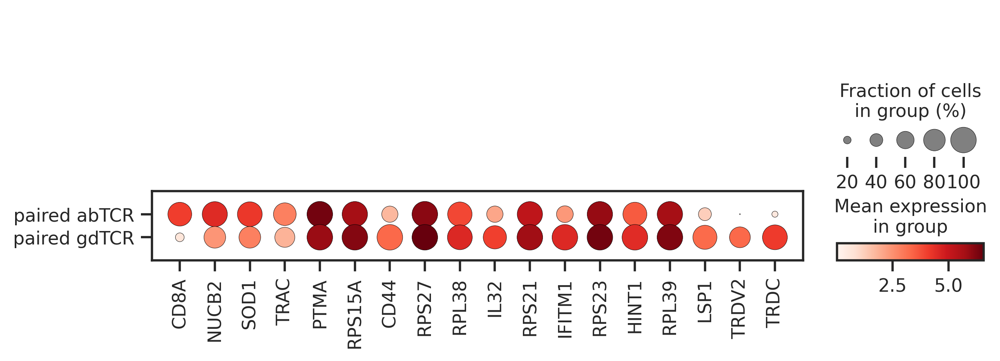

In [131]:
sc.pl.dotplot(gdT_select_ct, var_names=CD8AA_sig,groupby='TCR_combine',save = 'CD8AA_gd_ab_comparison.pdf')

# gd VDJ usage

In [60]:
adata_select = adata_gdtcr[adata_gdtcr.obs['gdTCR']=='paired_gdTCR']

In [223]:
#write csv for chi-square test
adata_select.obs.to_csv('csv/gdTCR_VDJ_usage.csv') 

In [122]:
# check all genes from adata are inside
TRGV_list = list(adata_select.obs['gd_IR_VJ_1_v_gene'].cat.categories)
TRGJ_list = list(adata_select.obs['gd_IR_VJ_1_j_gene'].cat.categories)
#TRGC_list = list(adata_select.obs['gd_IR_VJ_1_c_gene'].cat.categories[:-1])
TRDV_list = list(adata_select.obs['gd_IR_VDJ_1_v_gene'].cat.categories)
TRDD_list = list(adata_select.obs['gd_IR_VDJ_1_d_gene'].cat.categories[:-1])
TRDJ_list = list(adata_select.obs['gd_IR_VDJ_1_j_gene'].cat.categories[1:])
TCR_list = TRGV_list+TRGJ_list+TRDV_list+TRDD_list+TRDJ_list

In [99]:
TCR_list

['TRGV2*01',
 'TRGV2*02',
 'TRGV2*03',
 'TRGV3*01',
 'TRGV4*01',
 'TRGV4*02',
 'TRGV5*01',
 'TRGV8*01',
 'TRGV9*01',
 'TRGV9*01,TRGV9*02',
 'TRGV10*01,TRGV10*02',
 'TRGV10*02',
 'TRGV11*01,TRGV11*02',
 'TRGJ1*01',
 'TRGJ1*02,TRGJ2*01',
 'TRGJP1*01',
 'TRGJP2*01',
 'TRGJP*01',
 'TRAV29/DV5*01',
 'TRAV29/DV5*04',
 'TRAV36/DV7*01',
 'TRAV38-2/DV8*01',
 'TRDV1*01',
 'TRDV2*01',
 'TRDV2*03',
 'TRDV3*01',
 'TRDV3*01,TRDV3*02',
 'TRDD2*01',
 'TRDD3*01',
 'TRDJ1*01',
 'TRDJ2*01',
 'TRDJ3*01',
 'TRDJ4*01']

### heatmap plotting

In [123]:
ct_select =['CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T']
TCR_chain = pd.DataFrame(columns = TCR_list,  index = ct_select)

In [124]:
Dict = {'gd_IR_VJ_1_v_gene':TRGV_list,
        'gd_IR_VJ_1_j_gene': TRGJ_list,
        'gd_IR_VDJ_1_v_gene': TRDV_list,
       'gd_IR_VDJ_1_d_gene':TRDD_list,
       'gd_IR_VDJ_1_j_gene':TRDJ_list}

In [136]:
for i in range(TCR_chain.shape[0]):
    cell = TCR_chain.index[i]
    
    for chain_type in TCR_chain.columns:
        counter = [Counter(adata.obs.loc[adata.obs['anno_lvl_2_final_clean']==cell,name]) for name in Dict.keys() if chain_type in Dict[name]]
        
        TCR_chain.loc[cell,chain_type] = counter[0][chain_type]
        
    TCR_chain.loc[cell,:] = TCR_chain.loc[cell,:] / np.sum(TCR_chain.loc[cell,:]) * 100

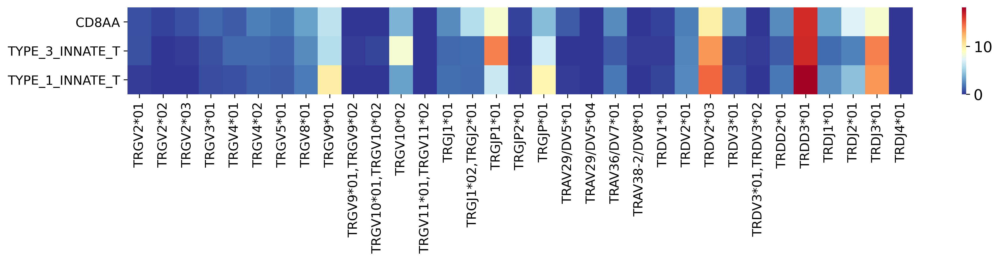

In [139]:
fig, ax = plt.subplots(figsize=(TCR_chain.shape[1]/2,TCR_chain.shape[0]/2))
#sb.set_theme()
uniform_data = TCR_chain
uniform_data=uniform_data.astype('float')
ax = sb.heatmap(uniform_data,cmap='RdYlBu_r', yticklabels=True)
_, xlabels = plt.xticks()
_, ylabels = plt.yticks()
ax.set_xticklabels(xlabels, size=12,rotation=90)
ax.set_yticklabels(ylabels, size=12,rotation=0)
plt.savefig(fig_path+'gdTCR_heatmap.pdf',bbox_inches='tight');

### chi-square test to look for differential usage across 3 cts

In [90]:
ct_select =['CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T']

In [91]:
TCR = pd.read_csv('csv/gdTCR_VDJ_usage.csv', index_col=0)

In [92]:
TCR = TCR.loc[TCR['anno_lvl_2_final_clean'].isin(ct_select),
              ['anno_lvl_2_final_clean','gd_IR_VDJ_1_v_gene', 'gd_IR_VDJ_1_j_gene', 'gd_IR_VJ_1_v_gene', 'gd_IR_VDJ_1_d_gene','gd_IR_VJ_1_j_gene']]

In [93]:
df = pd.DataFrame(columns=['pval','adj_pval'])

In [94]:
TCR_gene = ['gd_IR_VDJ_1_v_gene', 'gd_IR_VDJ_1_j_gene', 'gd_IR_VJ_1_v_gene', 'gd_IR_VJ_1_j_gene']
tot = Counter(TCR['anno_lvl_2_final_clean'])

for gene in TCR_gene:
    for chain in set(TCR[gene]):
        counter = Counter(TCR.loc[TCR[gene]==chain,'anno_lvl_2_final_clean'])
        observed = pd.DataFrame(index = ct_select,columns =['observed','rest'])
        for ct in ct_select:
            observed.loc[ct, 'observed']=counter[ct]
            observed.loc[ct, 'rest'] = tot[ct] - counter[ct]
        
        _,df.loc[chain,'pval'],_, _ = sp.stats.chi2_contingency(observed=observed)

In [95]:
# for adjusted pval calculation
from rpy2.robjects.packages import importr
from rpy2.robjects.vectors import FloatVector
stats = importr('stats') 

In [96]:
df.loc[:,'adj_pval']=stats.p_adjust(FloatVector(df.loc[:,'pval']), method = 'BH')

In [97]:
df.loc[df['adj_pval']< 0.05,:]

,pval,adj_pval
TRDV3*01,0.000292581,0.004242
TRDV2*03,0.00298853,0.014445
TRDJ3*01,0.000938138,0.006802
TRGV9*01,0.000675505,0.006530
"TRGJ1*02,TRGJ2*01",5.87167e-05,0.001703
TRGJP*01,0.00245379,0.014232
TRGJP1*01,0.00841725,0.034871


In [98]:
df

,pval,adj_pval
TRDV1*01,0.861126,0.863891
TRAV29/DV5*01,0.0359502,0.114554
TRDV3*01,0.000292581,0.004242
TRDV2*01,0.863891,0.863891
TRAV38-2/DV8*01,0.0664733,0.128515
"TRDV3*01,TRDV3*02",0.0664733,0.128515
TRDV2*03,0.00298853,0.014445
TRAV36/DV7*01,0.426387,0.618261
TRDJ3*01,0.000938138,0.006802
TRDJ1*01,0.112006,0.203010
